In [1]:
import random
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d

In [12]:
pcd = np.loadtxt("filtered.xyz", skiprows=1)

#Store in two variables
xyz=pcd[:,:3]
rgb=pcd[:,3:6]

In [14]:
pcd

array([[0.25434801, 0.5972392 , 0.38450566],
       [0.25803477, 0.59974885, 0.38594398],
       [0.26356983, 0.59953845, 0.38643312],
       ...,
       [0.16638316, 0.55435282, 0.61635035],
       [0.16954264, 0.55704695, 0.61852002],
       [0.16768631, 0.54814881, 0.61067063]])

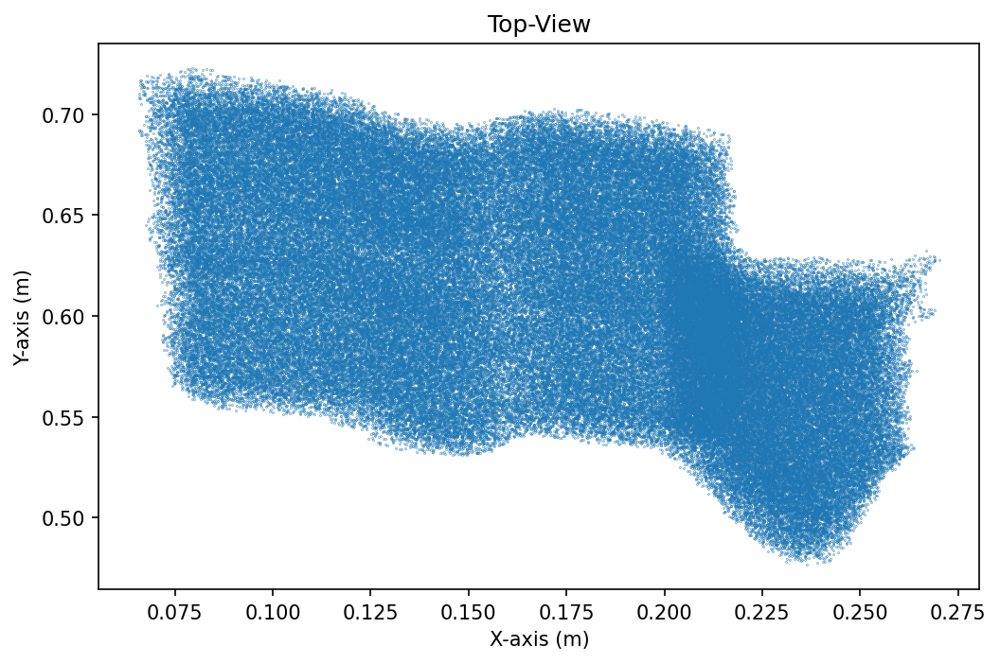

In [15]:
#Vizualising on the two axes to select the filter
plt.figure(figsize=(8, 5), dpi=150)
plt.scatter(xyz[:,0], xyz[:,1], s=0.05)
plt.title("Top-View")
plt.xlabel('X-axis (m)')
plt.ylabel('Y-axis (m)')
plt.show()

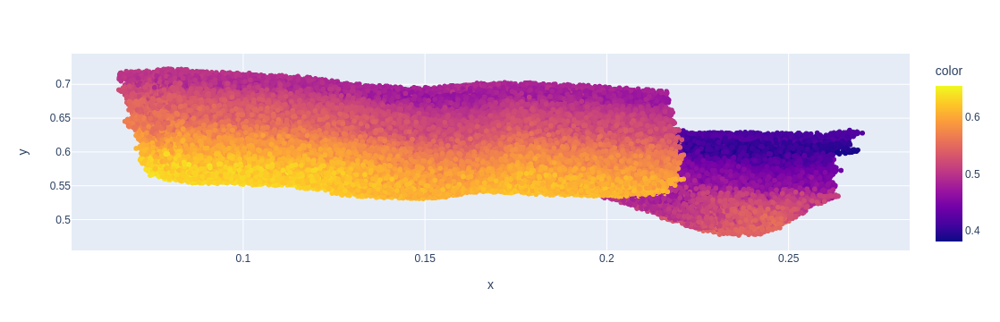

In [16]:
#for interactive plotting
import plotly.express as px
fig = px.scatter(x=xyz[:,0], y=xyz[:,1], color=xyz[:,2])
fig.show()

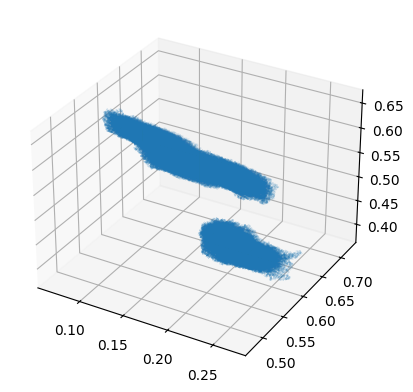

In [18]:
ax = plt.axes(projection='3d')
ax.scatter(xyz[:,0], xyz[:,1], xyz[:,2], s=0.01)
plt.show()

In [19]:
from sklearn.neighbors import KDTree
tree = KDTree(np.array(xyz), leaf_size=2)
nearest_dist, nearest_ind = tree.query(xyz, k=8)
mean_distance = np.mean(nearest_dist[:,1:])

In [20]:
#!! Blank iteration
inliers=[]
idx_samples = random.sample(range(len(xyz)), 3)
pts = xyz[idx_samples]

vecA = pts[1] - pts[0]
vecB = pts[2] - pts[0]
normal = np.cross(vecA, vecB)
a,b,c = normal / np.linalg.norm(normal)
d=-np.sum(normal*pts[1])

In [21]:
idx_inliers = []  # list of inliers ids
distance = (a * xyz[:,0] + b * xyz[:,1] + c * xyz[:,2] + d
            ) / np.sqrt(a ** 2 + b ** 2 + c ** 2)

threshold=0.05
idx_candidates = np.where(np.abs(distance) <= threshold)[0]
if len(idx_candidates) > len(inliers):
  equation = [a,b,c,d]
  inliers = idx_candidates

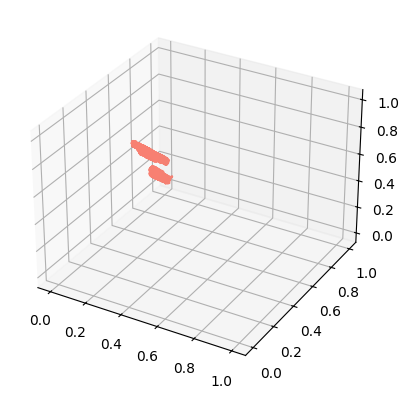

In [22]:
xyz_in=xyz[inliers]

mask = np.ones(len(xyz), dtype=bool)
mask[inliers] = False

xyz_out=xyz[mask]

ax = plt.axes(projection='3d')
ax.scatter(xyz_in[:,0], xyz_in[:,1], xyz_in[:,2], c = 'cornflowerblue', s=0.02)
ax.scatter(xyz_out[:,0], xyz_out[:,1], xyz_out[:,2], c = 'salmon', s=0.02)
plt.show()

In [23]:
def ransac_plane(xyz, threshold=0.05, iterations=1000):
  inliers=[]
  n_points=len(xyz)
  i=1

  while i<iterations:
    idx_samples = random.sample(range(n_points), 3)
    pts = xyz[idx_samples]

    vecA = pts[1] - pts[0]
    vecB = pts[2] - pts[0]
    normal = np.cross(vecA, vecB)
    a,b,c = normal / np.linalg.norm(normal)
    d=-np.sum(normal*pts[1])

    distance = (a * xyz[:,0] + b * xyz[:,1] + c * xyz[:,2] + d
                ) / np.sqrt(a ** 2 + b ** 2 + c ** 2) 

    idx_candidates = np.where(np.abs(distance) <= threshold)[0]

    if len(idx_candidates) > len(inliers):
      equation = [a,b,c,d]
      inliers = idx_candidates
    
    i+=1
  return equation, inliers

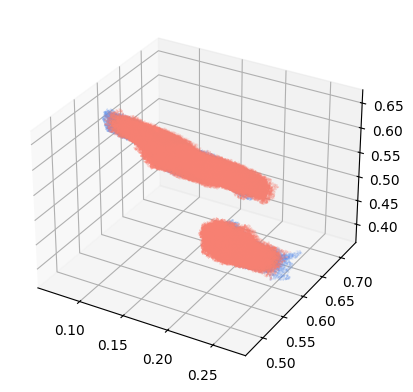

In [24]:
eq,idx_inliers=ransac_plane(xyz,0.01)
inliers=xyz[idx_inliers]

mask = np.ones(len(xyz), dtype=bool)
mask[idx_inliers] = False

outliers=xyz[mask]

ax = plt.axes(projection='3d')
ax.scatter(inliers[:,0], inliers[:,1], inliers[:,2], c = 'cornflowerblue', s=0.02)
ax.scatter(outliers[:,0], outliers[:,1], outliers[:,2], c = 'salmon', s=0.02)
plt.show()

In [25]:
np.savetxt("_inliers.xyz", inliers, fmt='%1.4f', delimiter=';')